<big style="font-size:30px;"><center><b>Лабораторная работа №4</b></center></big>

# Цель работы

Освоение принципов математической морфологии в области обработки и анализа изображений.

# Теоретические сведения

Термин _морфология_ дословно переводится как «наука о форме». Морфологический анализ используется во многих областях знаний, в т.ч. и в обработке изображений. Морфологический анализ является относительно универсальным подходом, поэтому стоит обособленно от всех рассмотренных ранее методов. С использованием математической морфологии при обработке изображений можно осуществлять фильтрацию шумов, сегментацию объектов, выделение контуров, реализовать поиск заданного объекта на изображении, вычислить «скелет» образа и т.д.

Рассмотрим основные операции бинарной морфологии над изображением $A$ структурным элементом $B$:

1. Дилатация (расширение, наращивание): $A \oplus B$, расширяет бинарный образ $A$ структурным элементом $B$;
2. Эрозия (сжатие, сужение): $A \ominus B$, сужает бинарный образ $A$ структурным элементом $B$;
3. Открытие (отмыкание, размыкание, раскрытие): $(A \ominus B) \oplus B$, удаляет внешние дефекты бинарного образа $A$ структурным элементом $B$;
4. Закрытие (замыкание): $(A \oplus B) \ominus B$, удаляет внутренние дефекты бинарного образа $A$ структурным элементом $B$,

где $\oplus$ и $\ominus$ — сложение и вычитание Минковского, соответственно.

<img src="./src/1.png" width=600 heigth=400>

В библиотеке OpenCV имеются следующие функции, предназначенные для работы с морфологией и морфологическими операциями:

1. `cv2.getStructuringElement(shape, size, anchor)` — задает структурный элемент заданной формы `shape` и размера `size`. Если параметр центральной точки `anchor` не задан, то центром структурного элемента становится его геометрический центр. Форма структурного элемента может быть одной из следующих:
    1. `cv2.MORPH_RECT` — структурный элемент прямоугольной формы размера `size`.
    2. `cv2.MORPH_CROSS` — структурный элемент в форме креста размера `size`.
    3. `cv2.MORPH_ELLIPSE` — структурный элемент эллиптической формы, вписанный в прямоугольник размера `size`.
2. `cv2.morphologyEx(A, op, B, anchor, iters, borderType, borderValue)` — применяет морфологическую операцию `op` к изображению `A` используя структурный элемент `B` `iter` раз. Если параметр `iters` не задан, то морфологическая операция выполняется 1 раз. Также можно задать центральную точку структурного элемента `anchor` и метод обработки граничных точек изображения. Используя данную функцию, можно выполнить следующие типы морфологических операций:
    1. `cv2.MORPH_ERODE` — эрозия. Для выполнения эрозии можно также использовать функцию `cv2.erode()`.
    2. `cv2.MORPH_DILATE` — дилатация. Для выполнения дилатации можно также использовать функцию `cv2.dilate()`.
    3. `cv2.MORPH_OPEN` — открытие. `open(A, B) = erode(dilate(A, B), B)`.
    4. `cv2.MORPH_CLOSE` — закрытие. `close(A, B) = erode(dilate(A, B), B)`.
    5. `cv2.MORPH_GRADIENT` — морфологический градиент. Результатом данной операции является разница между дилатацией и эрозией. `gradient(A, B) = dilate(A, B) - erode(A, B)`.
    6. `cv2.MORPH_TOPHAT` — операция «top hat». Результатом данной операции является разница между изображением и его открытием. `tophat(A, B) = A - open(A, B)`.
    7. `cv2.MORPH_BLACKHAT` — операция «black hat». Результатом данной операции является разница между закрытием изображения и им самим. `blackhat(A, B) = close(A, B)`.
    8. `cv2.MORPH_HITMISS` — операция «hit & miss».
3. `cv2.connectedComponents(A)` — формирует список всех связных компонент изображения `A`. Возвращает кортеж объектов, хранящий количество связных компонент и матрицу индексов компонент `labels`.
4. `cv2.connectedComponentsWithStats(A)` — то же самое, что и `connectedComponents()`, но кроме индексов компонент она также считает статистику для каждой компоненты. Возвращает кортеж объектов, хранящий количество связных компонент, матрицу индексов компонент `labels`, статистику `stats` и центры `centers`. Статистика `stats` представляет из себя двумерную матрицу, где первое измерение — индекс компоненты `(labels)`, а второе — индекс параметра. Тип данных матрицы — 32 битные целые числа со знаком `(int32)`. Центры `centers` — двумерная матрица, где первое измерение — это индекс компоненты `(label)`, а второе 0 для оси X и 1 для оси Y. Статистика включает в себя следующие данные:
    1. `cv2.CC_STAT_LEFT` — координата самого левого пикселя компоненты (X);
    2. `cv2.CC_STAT_TOP` — координата самого верхнего пикселя компоненты (Y);
    3. `cv2.CC_STAT_WIDTH` — горизонтальный размер компоненты (ширина);
    4. `cv2.CC_STAT_HEIGHT` — вертикальный размер компоненты (высота);
    5. `cv2.CC_STAT_AREA` — размер компоненты в пикселях.

## Примеры использования морфологических операций

### Выделение границ объектов

Границы объектов могут быть выделены с использованием следующего подхода:

1. $C = A - (A \ominus B)$ — формирование внутреннего контура;
2. $C = (A \oplus B) - B$ — формирование внешнего контура;

### Разделение «склеенных» объектов

Одним из примеров использования морфологических операций над изображением может быть задача разделения склеившихся на изображении объектов. Задача может быть решена с достаточной степенью точности при помощи последовательного выполнения нескольких раз фильтра сжатия, а затем максимально возможного расширения полученного результата. Пересечение исходного изображения с обработанным позволит разделить склеенные объекты.

<img src="./src/2.png" width=600 heigth=400>

### Сегментация методом управляемого водораздела

Рассмотрим еще один из примеров применения математической морфологии к задаче сегментации изображения. В подходе сегментации по водоразделам изображение рассматривается как карта высот, на котором интенсивности пикселей описывают высоты относительно некоторого уровня. На такую «высотную местность» «льет дождь», образуя множество _водосборных бассейнов_.

Постепенно вода из переполненных бассейнов переливается, и бассейны объединяются в более крупные (см. рис. 3). Места объединения бассейнов отмечаются как линии водораздела. Если «дождь» остановить рано, тогда изображение будет сегментировано на мелкие области, а если поздно — на крупные. В таком подходе все пиксели подразделяются на три типа:

1. _локальные минимумы_;
2. находящиеся _на склоне_ (с которых вода скатывается в один и тот же локальный минимум);
3. _локальные максимумы_ (с которых вода скатывается более чем в один минимум).

<img src="./src/3.png" width=600 heigth=400>

При реализации данного метода необходимо определить водосборные бассены и линии водораздела путем обработки локальных областей и вычисления их характеристик. Алгоритм сегментации состоит из следующих шагов:
    
1. Вычисление функции сегментации. Как правило, для этого используется градиентное представление изображения.
2. Вычисление маркеров переднего плана на основании связности пикселей каждого объекта.
3. Вычисление маркеров фона, представляющих пиксели, не являющиеся объектами.
4. Модифицирование функции сегментации с учетом взаиморасположения маркеров переднего плана и фона.

В результате работы алгоритма будет получена маска, где пиксели одинаковых сегментов будут помечены одинаковыми метками и будут образовывать связную область

# Ход выполнения работы

## Постановка задачи

1. _Базовые морфологические операции_. Выбрать произвольное изображение, содержащее дефекты формы (внутренние «дырки» или внешние «выступы») объектов. Используя базовые морфологические операции, полностью убрать или минимизировать дефекты.
2. _Разделение объектов_. Выбрать произвольное бинарное изображение, содержащее перекрывающиеся объекты. Использовать операции бинарной морфологии для разделения объектов. Выделить контуры объектов.
3. _Сегментация_. Выбрать произвольное изображение, содержащее небольшое число локальных минимумов. Выполнить сегментацию изображения по водоразделам.

## Библиотеки и настройки

In [1]:
import cv2
import numpy as np

from matplotlib import pyplot as plt
from typing import Tuple, List

In [2]:
%matplotlib inline

## Используемые функции

In [3]:
def show(images: List, labels: List[str] = None, figsize=(10, 5), dpi=150) -> None:

    if not isinstance(images, list):
        images = [images, ]
    if isinstance(labels, str):
        labels = [labels, ]
    
    for i, image in enumerate(images):
        fig, ax = plt.subplots(nrows=1, ncols=1,
                               figsize=figsize, dpi=dpi,
                               constrained_layout=True)
        if labels:
            fig.suptitle(labels[i])
        
        ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        ax.axis('off')
    
    plt.show()

## Базовые морфологические операции

In [4]:
def apply_morph(src_img, operations, kernels):
    
    def show_item(src_img, op_name, op_idx, ker_name, ker):
        img = cv2.morphologyEx(src_img, op_idx, ker)
        
        fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(10, 10),
                                dpi=150, constrained_layout=True)
        
        for ax, img in zip(axs, [src_img, img]):
            ax.axis('off')
            ax.imshow(img)
        
        axs[0].set_title('Исходное изображение')
        axs[1].set_title(f'{op_name} (kernel = {ker_name})')
        
        plt.show()
    
    
    for op_name, op_idx in operations.items():
        for ker_name in kernels:
            show_item(src_img, op_name, op_idx,
                      ker_name, kernels[ker_name])

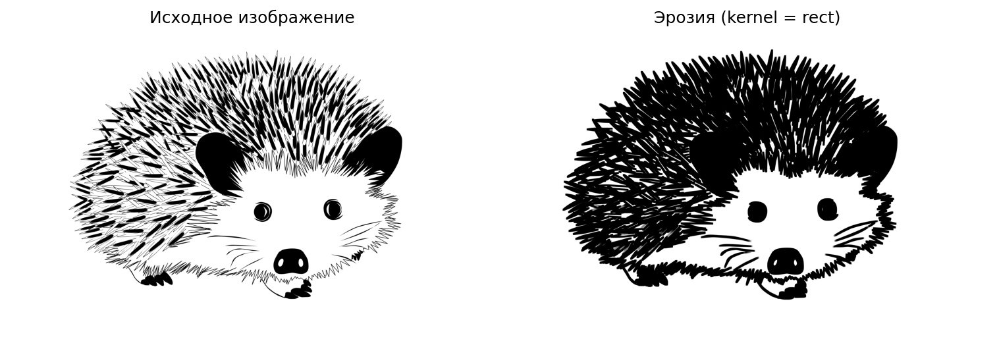

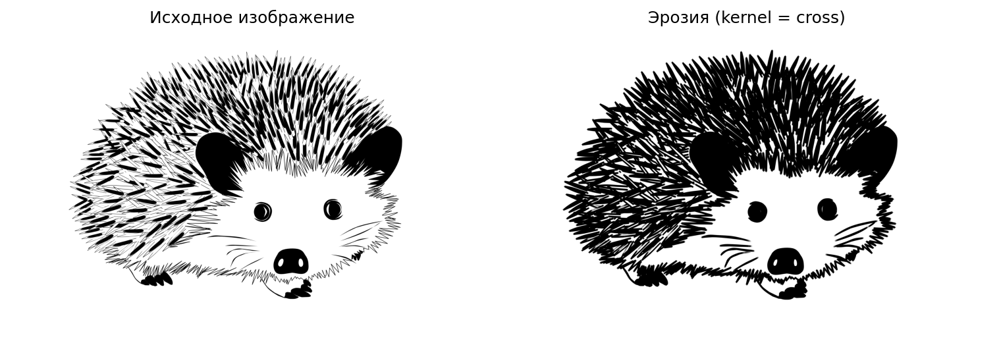

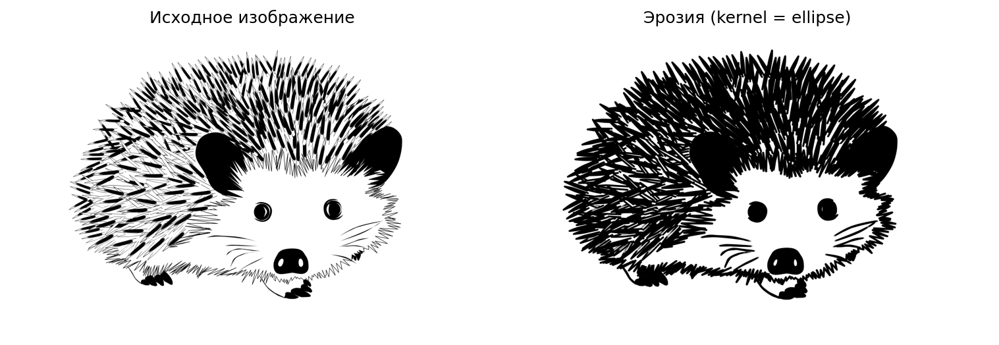

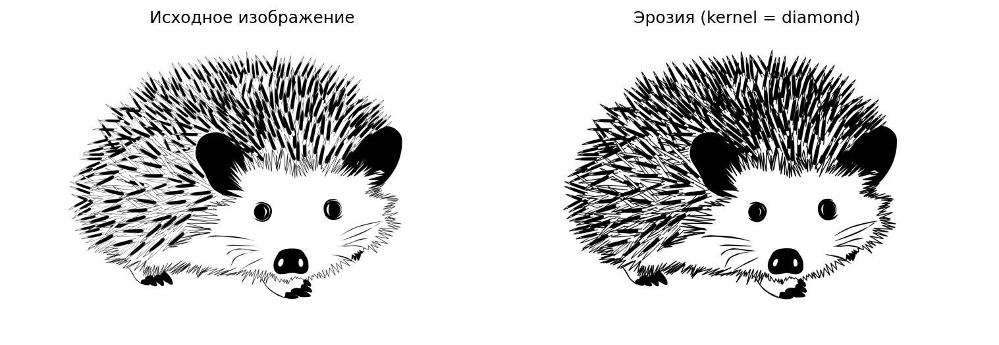

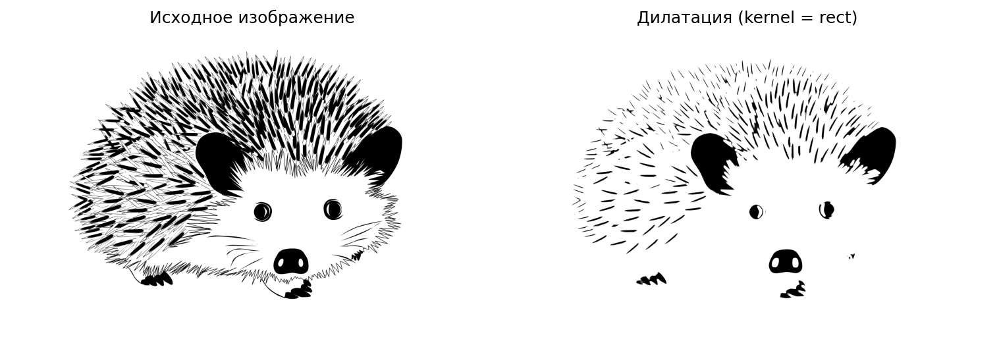

...

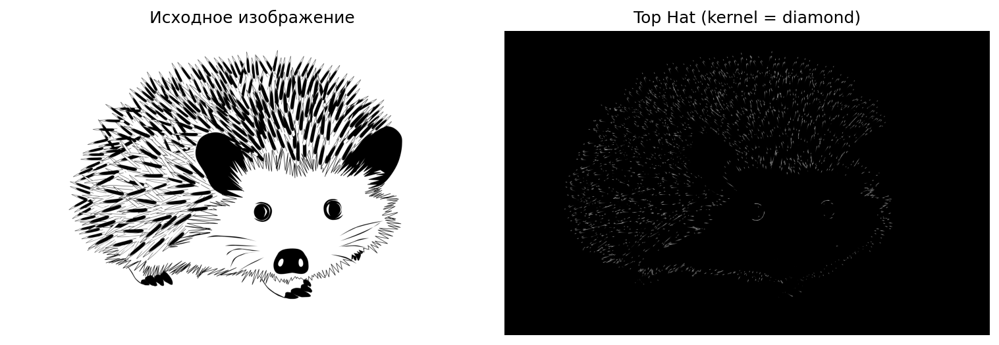

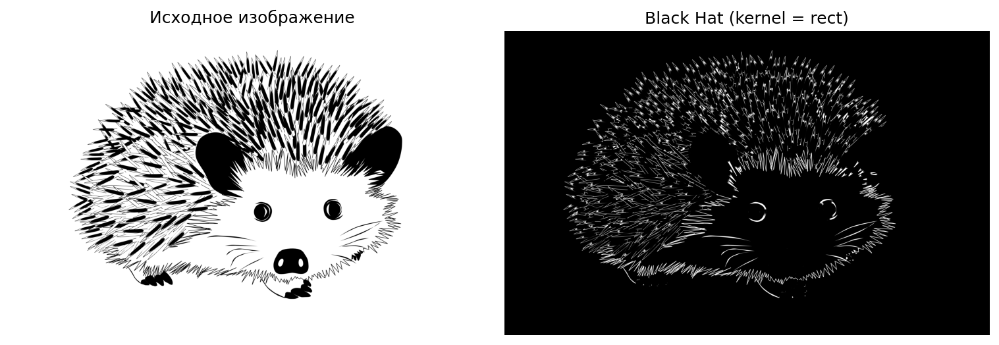

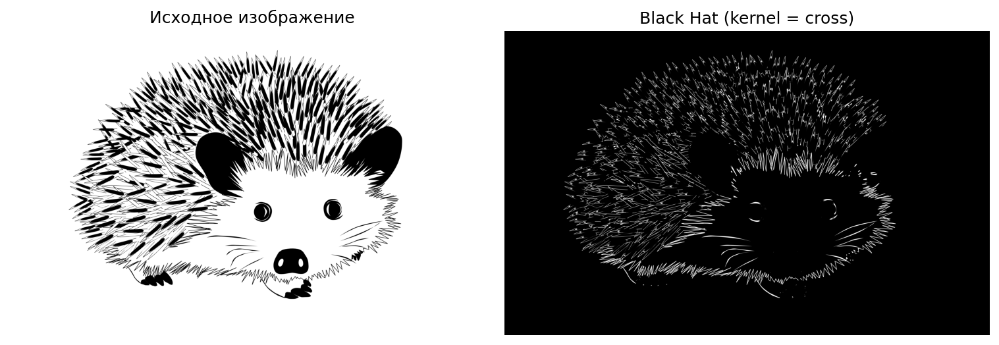

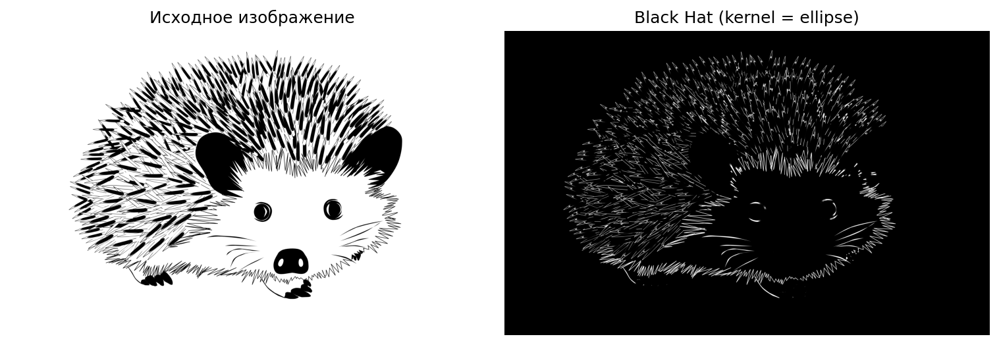

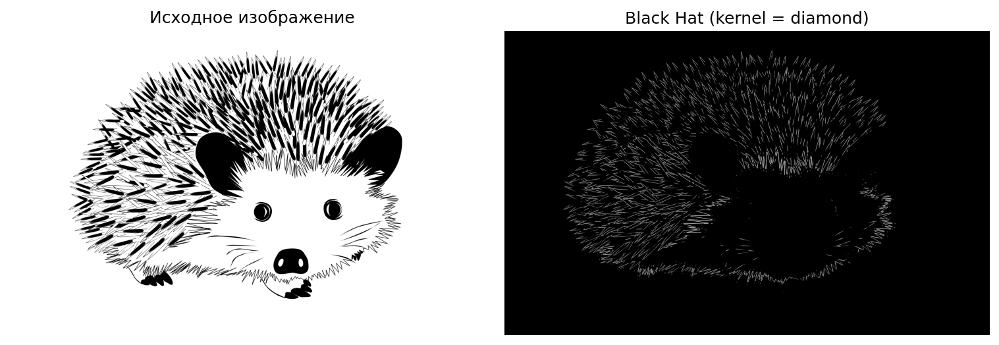

In [5]:
img = cv2.imread('./pictures/1.png')

size = 13
kernels = {
    'rect': cv2.getStructuringElement(cv2.MORPH_RECT, (size, size)),
    'cross': cv2.getStructuringElement(cv2.MORPH_CROSS, (size, size)),
    'ellipse': cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (size, size)),
    'diamond': np.array([[0, 0, 1, 0, 0],
                         [0, 1, 1, 1, 0],
                         [1, 1, 1, 1, 1],
                         [0, 1, 1, 1, 0],
                         [0, 0, 1, 0, 0]], dtype=np.uint8)
}

operations = {
    'Эрозия': cv2.MORPH_ERODE,
    'Дилатация': cv2.MORPH_DILATE,
    'Открытие': cv2.MORPH_OPEN,
    'Закрытие': cv2.MORPH_CLOSE,
    'Морфологический градиент': cv2.MORPH_GRADIENT,
    'Top Hat': cv2.MORPH_TOPHAT,
    'Black Hat': cv2.MORPH_BLACKHAT,
}

apply_morph(img, operations, kernels)

## Разделение объектов

In [6]:
def split_objects(image, iterations, threshold, ker=None):
    
    def dilates(erode):
        borders = np.zeros_like(erode)
        while cv2.countNonZero(erode) < erode.size:
            dilate = cv2.dilate(
                src=erode,
                kernel=ker,
                borderType=cv2.BORDER_CONSTANT,
                borderValue=(0)
            )
            close = cv2.morphologyEx(
                src=dilate,
                op=cv2.MORPH_CLOSE,
                kernel=ker,
                borderType=cv2.BORDER_CONSTANT,
                borderValue=(0)
            )
            S = close - dilate
            borders = cv2.bitwise_or(S, borders)
            erode = dilate
        return borders
    
    img = cv2.threshold(image, threshold, 255, cv2.THRESH_BINARY_INV)[1]
    ker = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 7))
    
    erode = cv2.morphologyEx(
        src=img,
        op=cv2.MORPH_ERODE,
        kernel=ker,
        iterations=iterations,
        borderType=cv2.BORDER_CONSTANT,
        borderValue=(0)
    )
    
    borders = dilates(erode)

    # Closing for borders
    borders = cv2.morphologyEx(
        src=borders,
        op=cv2.MORPH_CLOSE,
        kernel=ker,
        iterations=iterations,
        borderType=cv2.BORDER_CONSTANT,
        borderValue=(255)
    )
    
    return cv2.bitwise_and(~borders, img) # Del borders

In [7]:
img = cv2.imread('./pictures/2.png', cv2.IMREAD_GRAYSCALE)

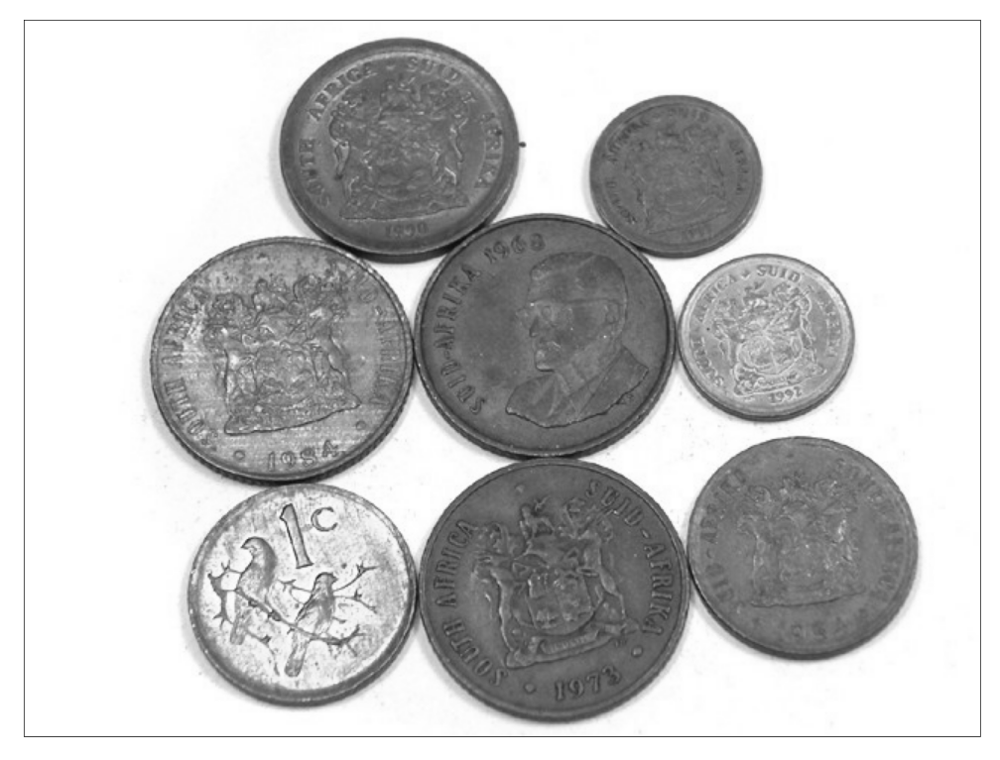

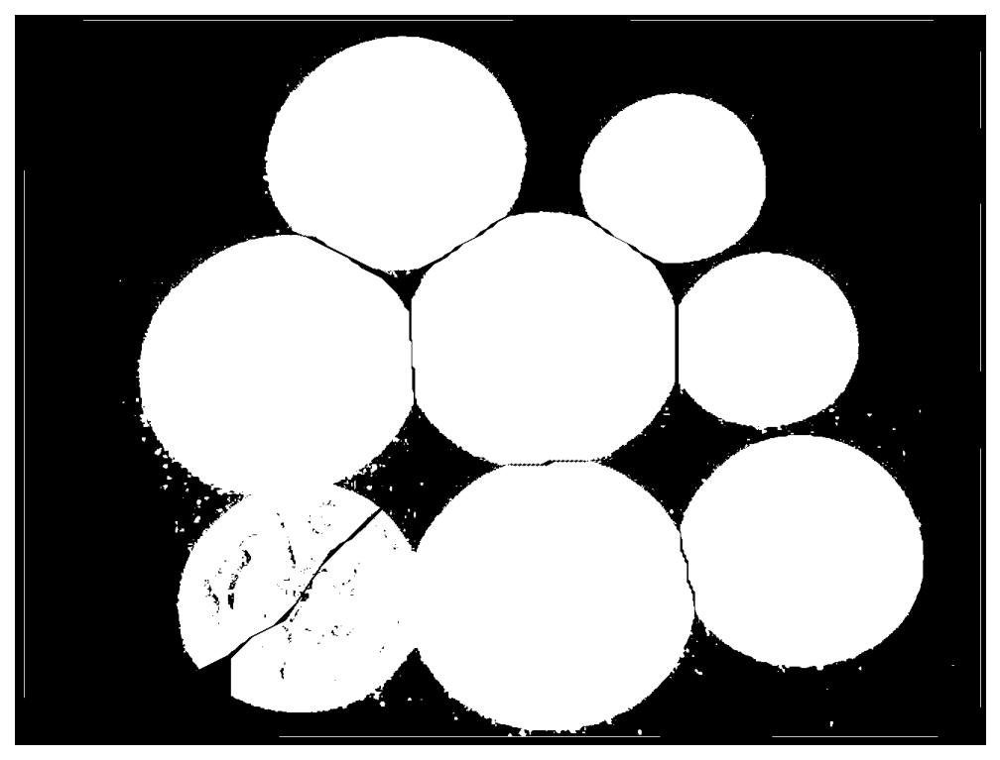

In [8]:
show([img, split_objects(img, iterations=29, threshold=248)])

## Сегментация

In [9]:
class ImageSegmentation:
    
    def __init__(self, img):
        self.img = img
        self.img_binary = None
        self.img_foreground = None
        self.img_background = None
        self.img_segmented = img.copy()
        self.markers_foreground = None
        self.markers_background = None
        self.markers_all = None
        
    def preprocess_img(self, dim=20, conn=8, kernel=(5, 5)):
        img_gray = cv2.cvtColor(self.img, cv2.COLOR_BGR2GRAY)
        
        img_binary = cv2.threshold(src=img_gray, thresh=0, maxval=255,
                                   type=cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]
        
        self.img_binary = cv2.morphologyEx(
            src=self.bwareaopen(img_binary, dim=dim, conn=conn),
            op=cv2.MORPH_CLOSE,
            kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, kernel))
        return self
    
    def foreground(self, threshold=0.1, mask_size=5):
        self.preprocess_img()
        dist = cv2.distanceTransform(self.img_binary, cv2.DIST_L2, mask_size)
        self.img_foreground = cv2.threshold(
            dist, threshold * dist.max(), 255, 0)[1].astype(np.uint8)
        self.markers_foreground = cv2.connectedComponents(self.img_foreground)[1]
        return self
    
    def background(self):
        self.foreground()
        self.img_background = np.zeros_like(self.img_binary)
        self.markers_background = cv2.watershed(self.img, self.markers_foreground.copy())
        self.img_background[self.markers_background == -1] = 255
        return self
    
    def segment(self, border_color=(255, 0, 0)):
        self.background()
        undefined_area = cv2.subtract(~self.img_background, self.img_foreground)
        markers = self.markers_foreground + 1
        markers[undefined_area == 255] = 0
        self.markers_all = cv2.watershed(self.img, markers)
        self.img_segmented[self.markers_all == -1] = border_color
        return self
        
    @staticmethod
    def apply_cmap(markers):
        return cv2.applyColorMap(
            (markers * 255 / (markers.max() + 1)).astype(np.uint8),
            cv2.COLORMAP_JET)
    
    @staticmethod
    def bwareaopen(img_binary, dim, conn=8):
        '''
        Удаляет все связанные компоненты
        
        Параметры
        ---------
        binary_image : ndarray
            Бинарное изображение
        dim : float
            Максимальное количество пикселей в объектах
        conn : Literal[4, 8]
            Пиксельная возможность соединения
        
        Возвращаемое значение
        ---------------------
        output_img : ndarray
            Открытое для области бинарное изображение
        '''
        
        if img_binary.ndim > 2:
            raise NotImplementedError

        # Find all connected components
        num, labels, stats, centers = cv2.connectedComponentsWithStats(img_binary, connectivity=conn)

        # Check size of all connected components
        for i in range(num):
            if stats[i, cv2.CC_STAT_AREA] < dim:
                img_binary[labels == i] = 0
    
        return img_binary

In [10]:
img = cv2.imread("./pictures/3.jpg", cv2.IMREAD_COLOR)
seg = ImageSegmentation(img).segment()

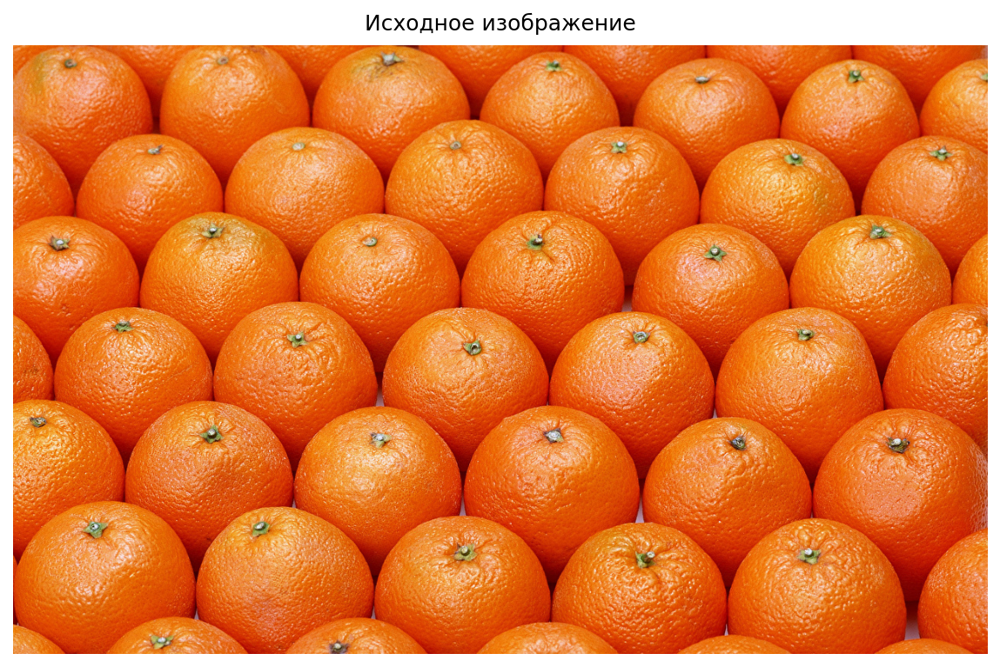

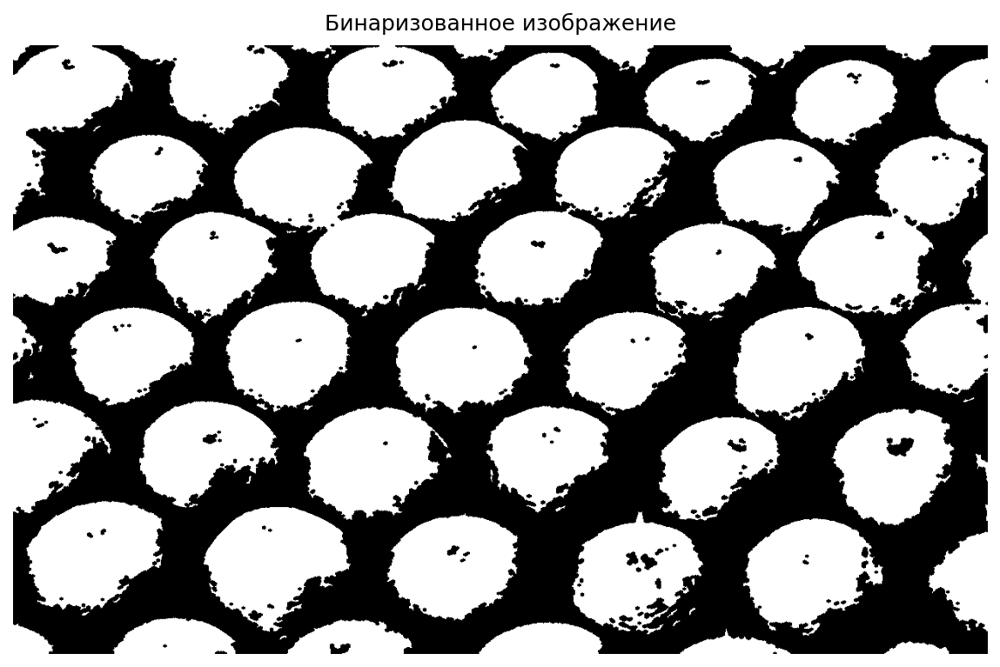

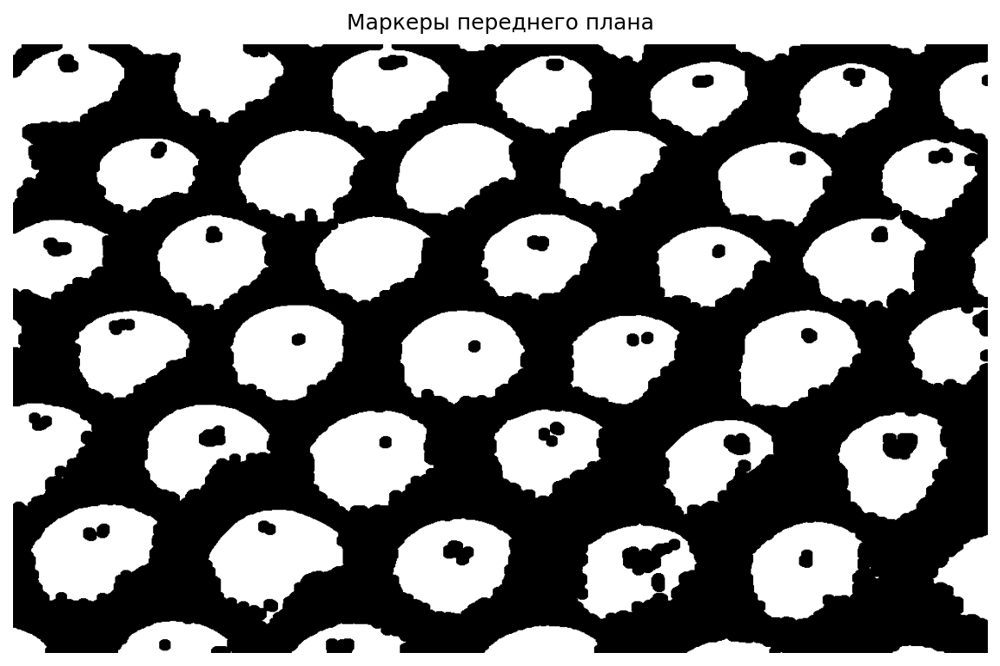

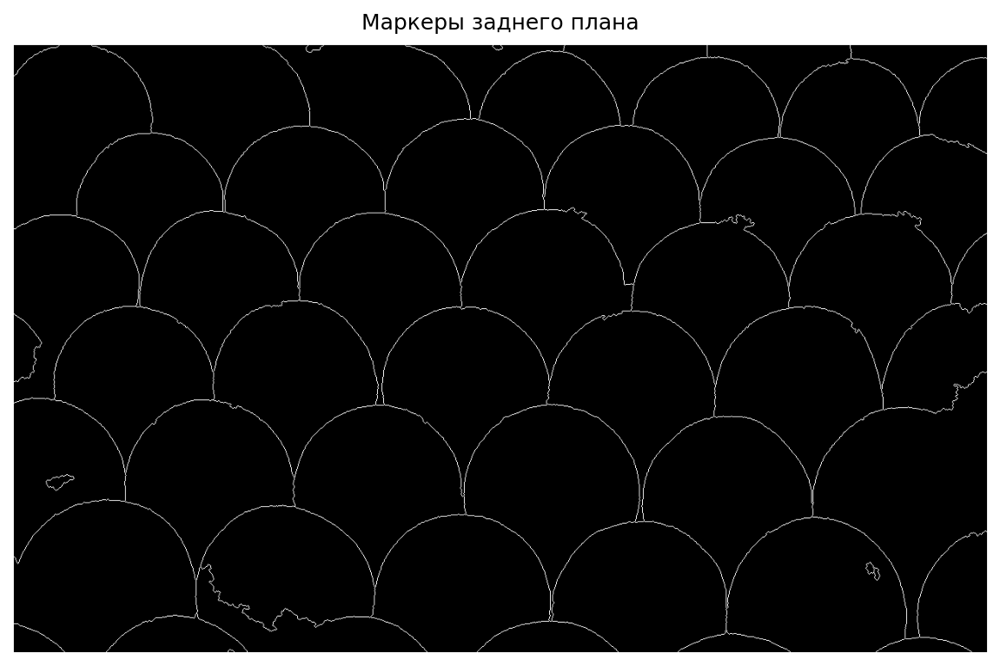

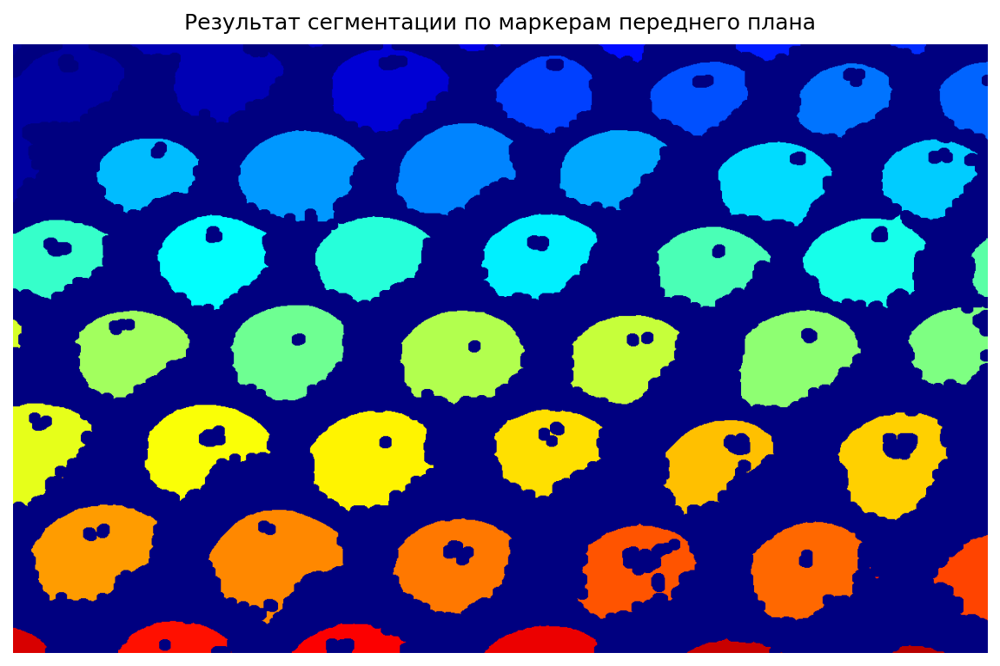

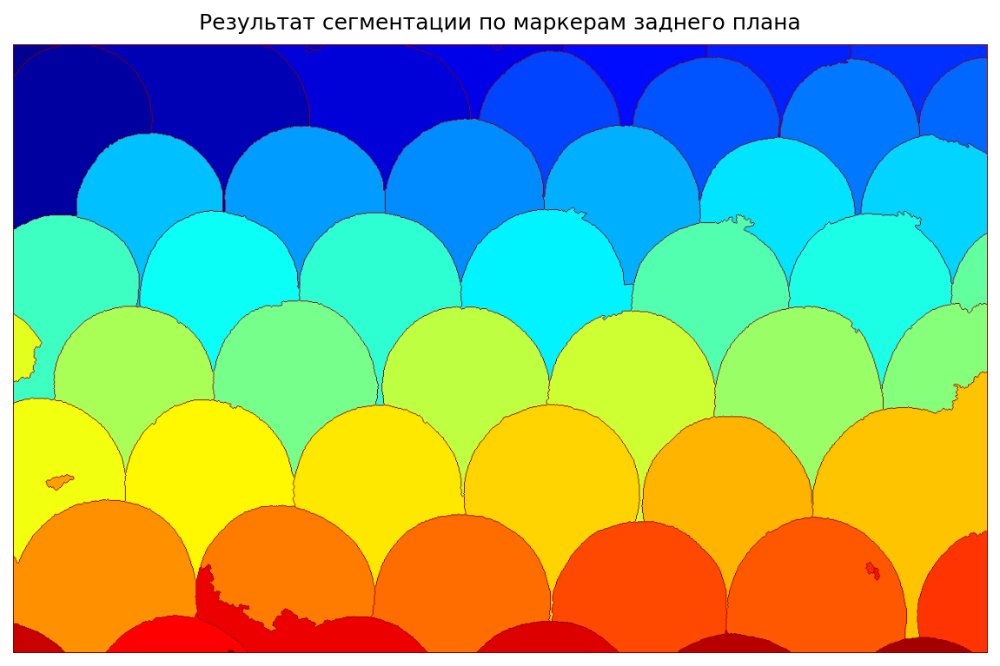

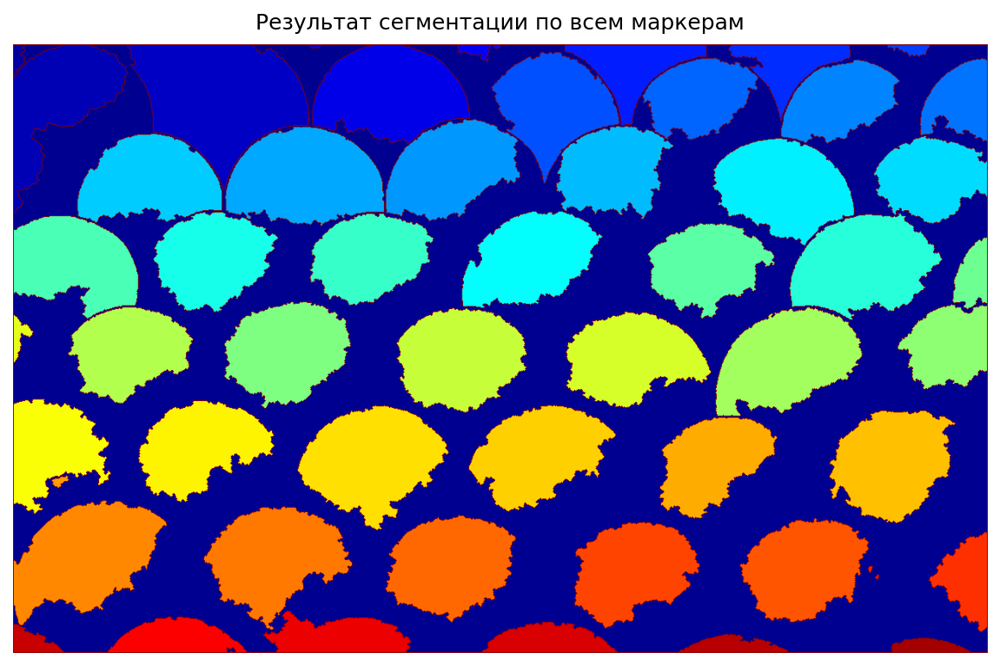

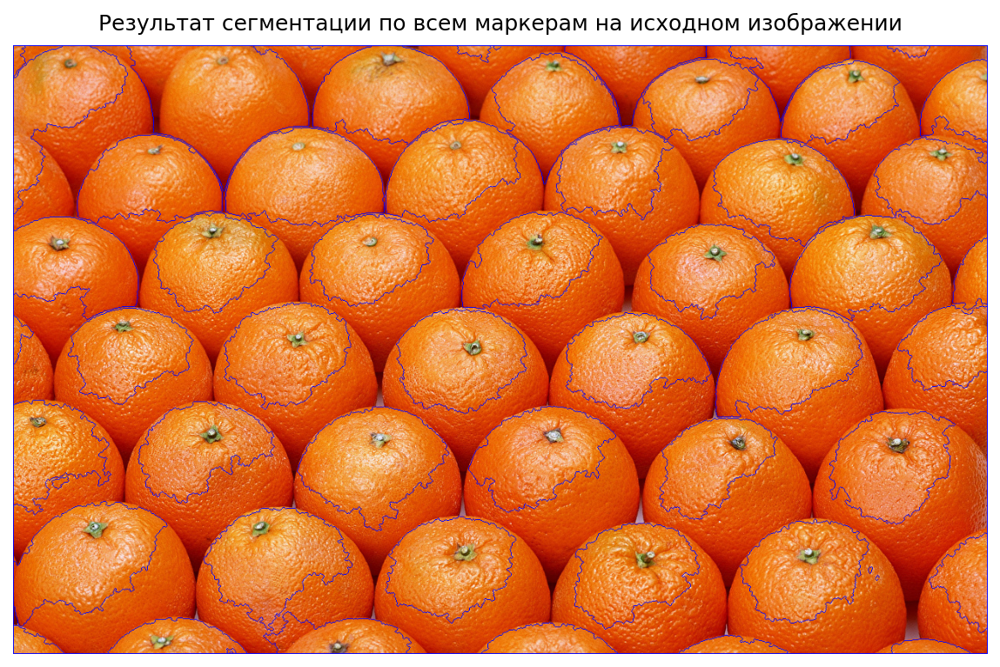

In [11]:
show(
    images=[
        seg.img,
        seg.img_binary,
        seg.img_foreground,
        seg.img_background,
        seg.apply_cmap(seg.markers_foreground),
        seg.apply_cmap(seg.markers_background),
        seg.apply_cmap(seg.markers_all),
        seg.img_segmented,
    ],
    labels=[
        'Исходное изображение',
        'Бинаризованное изображение',
        'Маркеры переднего плана',
        'Маркеры заднего плана',
        'Результат сегментации по маркерам переднего плана',
        'Результат сегментации по маркерам заднего плана',
        'Результат сегментации по всем маркерам',
        'Результат сегментации по всем маркерам на исходном изображении'
    ]
)

# Дополнительные источники

* [Анализ и обработка изображений с использованием операций математической морфологии, python и библиотеки OPEV](https://habr.com/ru/post/565378/)
* https://bestprogrammer.ru/programmirovanie-i-razrabotka/python-opencv-morfologicheskie-operatsii